In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import os
from idip_defend.utils.imagenet.eval_utils import class_id_to_name

## Making per-Attack Analyses

In [2]:
def process_log(log_path):
    num_attacks_so_far = len(os.listdir(log_path))
    effective_num_attacks = num_attacks_so_far
    past_example_losses = []
    current_example_losses = []
    total_example_losses = []
    
    all_stats = {
        "original": {
            "imgs": [],
            "logits": [],
        },
        "attacked": {
            "imgs": [],
            "logits": [],
        },
        "ses_defense": {
            "imgs": [
                [] for _ in range(num_attacks_so_far)
            ],
            "logits": [
                [] for _ in range(num_attacks_so_far)
            ],
        },
    }
    
    # Iterate through each turn of attack
    for attack_num in range(num_attacks_so_far):
        file_name = f"{log_path}/attack_{attack_num}_status.pt"
        try:
            with open(file_name, "rb") as f:
                stats = torch.load(f, map_location="cpu", weights_only=False)
                
                # Append original and attacked images/logits
                original_img, original_logits = stats['original_img']
                attacked_img, attacked_logits = stats['attacked_img']
                all_stats["original"]["imgs"].append(original_img[0].transpose(1, 2, 0))
                all_stats["original"]["logits"].append(original_logits)
                all_stats["attacked"]["imgs"].append(attacked_img[0].transpose(1, 2, 0))
                all_stats["attacked"]["logits"].append(attacked_logits)
                
                ses_img, ses_logits = stats['ses_defense_img']
                all_stats["ses_defense"]["imgs"][attack_num].append(ses_img.transpose(1, 2, 0))
                all_stats["ses_defense"]["logits"][attack_num].append(ses_logits)
                
                # Append training losses
                if "total_losses" in stats["defense_info"]:
                    total_example_losses.append(
                        [
                            elem.item() for elem in stats["defense_info"]["total_losses"]
                        ]
                    )
                    current_example_losses.append(stats["defense_info"]["current_example_losses"])
                    past_example_losses.append(stats["defense_info"]["past_example_losses"])
                
                # Append per-attack statistics/outputs
                for past_example_idx in range(attack_num):
                    if "retrain" not in log_path and "past_defenses" in stats['defense_info']:
                        all_stats["ses_defense"]["imgs"][past_example_idx].append(
                            stats['defense_info']['past_defenses'][past_example_idx]
                        )
                    if "past_attacks_logits" in stats:
                        all_stats["ses_defense"]["logits"][past_example_idx].append(
                            stats['past_attacks_logits'][past_example_idx]
                        )
                    
            f.close()
            
        except Exception as e:
            print(f"Error processing file {file_name}: {e}")
            effective_num_attacks -= 1
            continue
    
    return {
        "log_stats": all_stats,
        "past_example_losses": past_example_losses,
        "current_example_losses": current_example_losses,
        "total_example_losses": total_example_losses,
        "num_attacks_recorded": effective_num_attacks,
    }

In [3]:
def compute_success_rates(log_data):
    num_attacks = log_data['num_attacks_recorded']
    original_correct_classes = [
        np.argmax(log_data['log_stats']['original']['logits'][i]) for i in range(num_attacks)
    ]
    attacked_resulting_classes = [
        np.argmax(log_data['log_stats']['attacked']['logits'][i]) for i in range(num_attacks)
    ]
    # Get decoupled version of success rates
    success_rates = []
    for attack_turn_idx in range(num_attacks):
        defense_record = []
        for attack_idx in range(attack_turn_idx + 1):
            defended_logits = log_data['log_stats']['ses_defense']['logits'][attack_idx][attack_turn_idx - attack_idx]
            defended_class = np.argmax(defended_logits)
            defense_record.append(defended_class == original_correct_classes[attack_idx])
        success_rate = sum(defense_record) / len(defense_record)
        success_rates.append(success_rate)
    return success_rates

In [12]:
def compute_concurrent_defense_rate(log_data):
    num_attacks = log_data['num_attacks_recorded']
    original_correct_classes = [
        np.argmax(log_data['log_stats']['original']['logits'][i]) for i in range(num_attacks)
    ]
    attacked_resulting_classes = [
        np.argmax(log_data['log_stats']['attacked']['logits'][i]) for i in range(num_attacks)
    ]
    # Get decoupled version of success rates
    successes = []
    for attack_idx in range(num_attacks):
        defended_logits = log_data['log_stats']['ses_defense']['logits'][attack_idx][0]
        defended_class = np.argmax(defended_logits)
        successes.append(defended_class == original_correct_classes[attack_idx])
    success_rate = np.cumsum(successes) / np.arange(1, num_attacks + 1)
    return success_rate

In [5]:
def compute_attack_success_rate(log_data):
    num_attacks = log_data['num_attacks_recorded']
    original_correct_classes = [
        np.argmax(log_data['log_stats']['original']['logits'][i]) for i in range(num_attacks)
    ]
    attacked_resulting_classes = [
        np.argmax(log_data['log_stats']['attacked']['logits'][i]) for i in range(num_attacks)
    ]
    return np.mean(
        [
            attacked_resulting_classes[i] != original_correct_classes[i]
            for i in range(num_attacks)
        ]
    )

In [6]:
def process_log_without_images(log_path):
    num_attacks_so_far = len(os.listdir(log_path))
    effective_num_attacks = num_attacks_so_far
    past_example_losses = []
    current_example_losses = []
    total_example_losses = []
    
    all_stats = {
        "original": {
            "logits": [],
        },
        "attacked": {
            "logits": [],
        },
        "ses_defense": {
            "logits": [
                [] for _ in range(num_attacks_so_far)
            ],
        },
    }
    
    # Iterate through each turn of attack
    for attack_num in range(num_attacks_so_far):
        file_name = f"{log_path}/attack_{attack_num}_status.pt"
        try:
            with open(file_name, "rb") as f:
                stats = torch.load(f, map_location="cpu", weights_only=False)
                
                # Append original and attacked images/logits
                original_img, original_logits = stats['original_img']
                attacked_img, attacked_logits = stats['attacked_img']
                all_stats["original"]["logits"].append(original_logits)
                all_stats["attacked"]["logits"].append(attacked_logits)
                
                ses_img, ses_logits = stats['ses_defense_img']
                all_stats["ses_defense"]["logits"][attack_num].append(ses_logits)
                
                # Append training losses
                if "total_losses" in stats["defense_info"]:
                    total_example_losses.append(
                        [
                            elem.item() for elem in stats["defense_info"]["total_losses"]
                        ]
                    )
                    current_example_losses.append(stats["defense_info"]["current_example_losses"])
                    past_example_losses.append(stats["defense_info"]["past_example_losses"])
                
                # Append per-attack statistics/outputs
                for past_example_idx in range(attack_num):
                    if "past_attacks_logits" in stats:
                        all_stats["ses_defense"]["logits"][past_example_idx].append(
                            stats['past_attacks_logits'][past_example_idx]
                        )
                    
            f.close()
            
        except Exception as e:
            print(f"Error processing file {file_name}: {e}")
            effective_num_attacks -= 1
            continue
    
    return {
        "log_stats": all_stats,
        "past_example_losses": past_example_losses,
        "current_example_losses": current_example_losses,
        "total_example_losses": total_example_losses,
        "num_attacks_recorded": effective_num_attacks,
    }

## Examplar Processing

In [109]:
log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint"
defense_type = "incremental"
defense_method = "ewc"

log_dir = f"{log_sources}/{defense_type}/{defense_method}"

ewc_logs = process_log(log_dir)

Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint/incremental/ewc/attack_38_status.pt: PytorchStreamReader failed reading zip archive: failed finding central directory


In [110]:
with open(f"{log_dir}/attack_10_status.pt", "rb") as f:
    stats = torch.load(f, map_location="cpu", weights_only=False)
stats.keys(), stats['defense_info'].keys()

(dict_keys(['original_img', 'attacked_img', 'psnr_max_defense_img', 'ses_defense_img', 'defense_info', 'past_attacks_logits']),
 dict_keys(['series', 'out_series', 'delta_series', 'total_losses', 'past_example_losses', 'current_example_losses', 'past_defenses']))

In [60]:
log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint"
defense_type = "incremental"
defense_method = "spectral_anchor_ma5_aw0.0005_ni2400"

log_dir = f"{log_sources}/{defense_type}/{defense_method}"

examplar_mse_logs = process_log(log_dir)

NameError: name 'process_log' is not defined

In [144]:
log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint"
defense_type = "retrain"
defense_method = "use_anchor_ni2400"

log_dir = f"{log_sources}/{defense_type}/{defense_method}"

exemplar_retrain_logs = process_log(log_dir)

In [ ]:
def compute_success_rates(log_data):
    num_attacks = log_data['num_attacks_recorded']
    original_correct_classes = [
        np.argmax(log_data['log_stats']['original']['logits'][i]) for i in range(num_attacks)
    ]
    attacked_resulting_classes = [
        np.argmax(log_data['log_stats']['attacked']['logits'][i]) for i in range(num_attacks)
    ]
    # Get decoupled version of success rates
    success_rates = []
    for attack_turn_idx in range(num_attacks):
        defense_record = []
        for attack_idx in range(attack_turn_idx + 1):
            defended_logits = log_data['log_stats']['ses_defense']['logits'][attack_idx][attack_turn_idx - attack_idx]
            defended_class = np.argmax(defended_logits)
            defense_record.append(defended_class == original_correct_classes[attack_idx])
        success_rate = sum(defense_record) / len(defense_record)
        success_rates.append(success_rate)
    return success_rates

In [145]:
example_mse_success_rates = compute_success_rates(examplar_mse_logs)
example_retrain_success_rates = compute_success_rates(exemplar_retrain_logs)

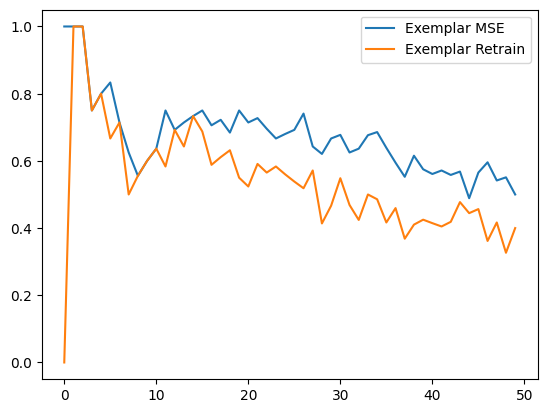

In [146]:
plt.plot(example_mse_success_rates, label="Exemplar MSE")
plt.plot(example_retrain_success_rates, label="Exemplar Retrain")
plt.legend()

In [ ]:
target_log = examplar_mse_logs


img_idxs_targeted = [
    0, 2, 4, 9, 19, 29, 39, 45, 47, 49
]

def plot_defense_progression(target_log, img_idxs_targeted):
    num_imgs_targeted = len(img_idxs_targeted)
    fig, axs = plt.subplots(
        (num_imgs_targeted + 2),
        num_imgs_targeted,
        figsize=(num_imgs_targeted * 6, (num_imgs_targeted + 2) * 6)
    )
    label_fontsize = num_imgs_targeted * 3.5

    for row_idx in range(num_imgs_targeted + 2):
        for col_idx in range(num_imgs_targeted):
            ax = axs[row_idx, col_idx]
            
            img_idx = img_idxs_targeted[col_idx]
            
            if row_idx == 0:
                img = target_log['log_stats']['original']['imgs'][img_idx]
                ax.imshow(
                    np.clip(img, 0, 1)
                )
            elif row_idx == 1:
                img = target_log['log_stats']['attacked']['imgs'][img_idx]
                ax.imshow(
                    np.clip(img, 0, 1)
                )
                identified_class = np.argmax(target_log['log_stats']['attacked']['logits'][img_idx])
                ax.set_title(f"Attacked Class:\n{class_id_to_name(identified_class)} ({identified_class})", fontsize=label_fontsize * 0.8)
            else:
                defense_turn = img_idxs_targeted[row_idx - 2]
                if img_idx <= defense_turn:
                    img = target_log['log_stats']['ses_defense']['imgs'][img_idx][defense_turn - img_idx]
                    if img.ndim == 4:
                        img = img.detach()[0].numpy().transpose(1, 2, 0)
                    ax.imshow(
                        np.clip(img, 0, 1)
                    )
                    identified_class = np.argmax(target_log['log_stats']['ses_defense']['logits'][img_idx][defense_turn - img_idx])
                    ax.set_title(f"Defended Class:\n{class_id_to_name(identified_class)} ({identified_class})", fontsize=label_fontsize * 0.8)

                    
            ax.set_xticks([])
            ax.set_yticks([])
            for spine in ax.spines.values():
                spine.set_visible(False)

    axs[0, 0].set_ylabel("Original", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
    axs[1, 0].set_ylabel("Attacked", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
    for i in range(num_imgs_targeted):
        current_class = np.argmax(target_log['log_stats']['original']['logits'][i])
        axs[i + 2, 0].set_ylabel(f"Defended\n Attack Turn {img_idxs_targeted[i] + 1}", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
        axs[0, i].set_title(f"Img {img_idxs_targeted[i]}\nOriginal Class:\n{class_id_to_name(current_class)} ({current_class})", fontsize=label_fontsize * 0.8)

    plt.tight_layout()
    plt.show()

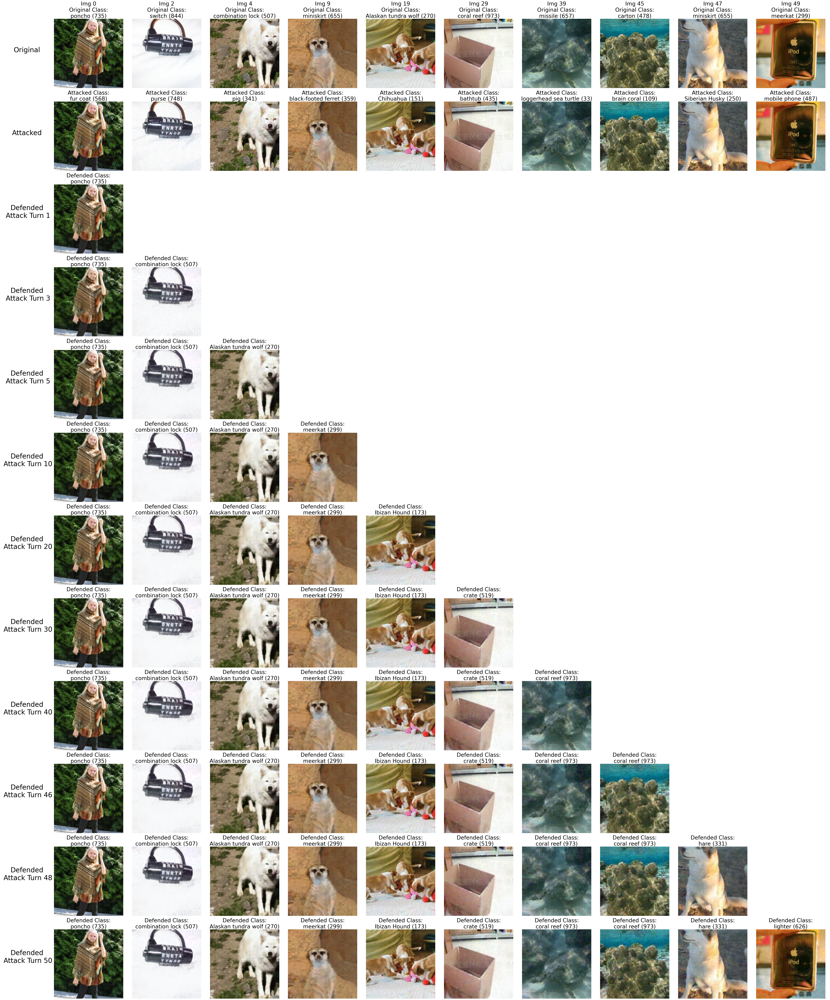

In [ ]:
target_log = examplar_mse_logs


img_idxs_targeted = [
    0, 2, 4, 9, 19, 29, 39, 45, 47, 49
]

plot_defense_progression(target_log, img_idxs_targeted)

## Processing Data

In [17]:
def process_specific_seed(seed):
    if seed == 0:
        log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint"
    else:
        log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint_1123"

    if seed == 0:
        incremental_logs = {
            dir_name: process_log_without_images(f"{log_sources}/incremental/{dir_name}")
            for dir_name in os.listdir(f"{log_sources}/incremental")
            if os.path.isdir(f"{log_sources}/incremental/{dir_name}")
        }
        retraining_logs = {
            dir_name: process_log_without_images(f"{log_sources}/retrain/{dir_name}")
            for dir_name in os.listdir(f"{log_sources}/retrain")
            if os.path.isdir(f"{log_sources}/retrain/{dir_name}")
        }        
    else:
        incremental_logs = {
            dir_name[:-2]: process_log_without_images(f"{log_sources}/incremental/{dir_name}")
            for dir_name in os.listdir(f"{log_sources}/incremental")
            if os.path.isdir(f"{log_sources}/incremental/{dir_name}") and dir_name[-1] == str(seed)
        }
        retraining_logs = {
            dir_name[:-2]: process_log_without_images(f"{log_sources}/retrain/{dir_name}")
            for dir_name in os.listdir(f"{log_sources}/retrain")
            if os.path.isdir(f"{log_sources}/retrain/{dir_name}") and dir_name[-1] == str(seed)
        }
    incremental_success_rates = {
        dir_name: compute_success_rates(incremental_logs[dir_name])
        for dir_name in incremental_logs
    }
    retraining_success_rates = {
        dir_name: compute_success_rates(retraining_logs[dir_name])
        for dir_name in retraining_logs
    }
    inc_concurrent_defense_rates = {
        dir_name: compute_concurrent_defense_rate(incremental_logs[dir_name])
        for dir_name in incremental_logs
    }
    ret_concurrent_defense_rates = {
        dir_name: compute_concurrent_defense_rate(retraining_logs[dir_name])
        for dir_name in retraining_logs
    }
    
    return {
        "incremental_logs": incremental_logs,
        "retraining_logs": retraining_logs,
        "incremental_success_rates": incremental_success_rates,
        "retraining_success_rates": retraining_success_rates,
        "inc_concurrent_defense_rates": inc_concurrent_defense_rates,
        "ret_concurrent_defense_rates": ret_concurrent_defense_rates,
    }

In [18]:
all_logs_and_stats = {
    seed: process_specific_seed(seed)
    for seed in [0, 1, 2, 3, 4]
}

Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint/incremental/ewc/attack_38_status.pt: PytorchStreamReader failed reading zip archive: failed finding central directory
Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint_1123/incremental/ewc_1/attack_38_status.pt: PytorchStreamReader failed reading zip archive: failed finding central directory
Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint_1123/incremental/ewc_2/attack_38_status.pt: PytorchStreamReader failed reading zip archive: failed finding central directory
Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint_1123/incremental/ewc_3/attack_38_status.pt: PytorchStreamReader failed reading zip archive: failed finding central directory
Error processing file /home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint_1123/incremental/ewc_4/attack_38_stat

In [20]:
all_logs_and_stats[0]["incremental_success_rates"].keys() == all_logs_and_stats[1]["incremental_success_rates"].keys()

True

In [21]:
def get_across_seed_aggregatins(dir_key):
    return {
        k: (
            np.mean(
                [
                    all_logs_and_stats[seed][dir_key][k]
                    for seed in all_logs_and_stats
                ],
                axis=0
            ),
            np.std(
                [
                    all_logs_and_stats[seed][dir_key][k]
                    for seed in all_logs_and_stats
                ],
                axis=0
            )
        ) for k in all_logs_and_stats[0][dir_key]
    }

In [22]:
incremental_success_rates = get_across_seed_aggregatins("incremental_success_rates")
retraining_success_rates = get_across_seed_aggregatins("retraining_success_rates")
inc_concurrent_defense_rates = get_across_seed_aggregatins("inc_concurrent_defense_rates")
ret_concurrent_defense_rates = get_across_seed_aggregatins("ret_concurrent_defense_rates")

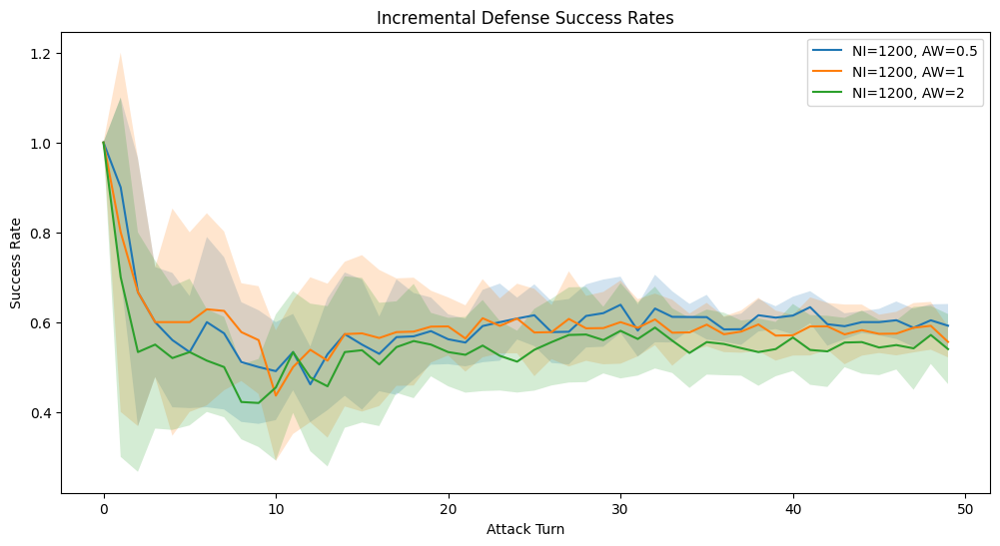

In [24]:
# First plot: compare mse anchoring with anchor weights and number of iterations
ni_s = [1200]
aw_s = [0.5, 1, 2]

fig, ax = plt.subplots(figsize=(12, 6))
for i, ni in enumerate(ni_s):
    for j, aw in enumerate(aw_s):
        dir_name = f"mse_anchor_aw{aw}_ni{ni}"
        if dir_name in incremental_success_rates:
            mean, std = incremental_success_rates[dir_name]
            ax.plot(
                mean,
                label=f"NI={ni}, AW={aw}"
            )
            ax.fill_between(
                np.arange(len(mean)),
                mean - std,
                mean + std,
                alpha=0.2
            )
ax.set_title("Incremental Defense Success Rates")
ax.set_xlabel("Attack Turn")
ax.set_ylabel("Success Rate")
ax.legend()

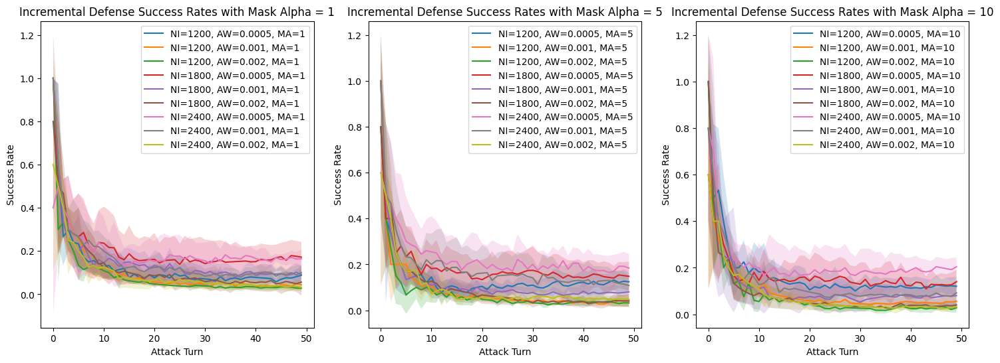

In [25]:
# Second plot: compare mse anchoring with anchor weights and number of iterations and mask alpha
ni_s = [1200, 1800, 2400]
aw_s = [0.0005, 0.001, 0.002]
ma_s = [1, 5, 10]

fig, axs = plt.subplots(1, 3, figsize=(18, 6))

for k, ma in enumerate(ma_s):
    ax = axs[k]
    for i, ni in enumerate(ni_s):
        for j, aw in enumerate(aw_s):
            dir_name = f"spectral_anchor_ma{ma}_aw{aw}_ni{ni}"
            if dir_name in incremental_success_rates:
                mean, std = incremental_success_rates[dir_name]
                ax.plot(
                    mean,
                    label=f"NI={ni}, AW={aw}, MA={ma}"
                )
                ax.fill_between(
                    np.arange(len(mean)),
                    mean - std,
                    mean + std,
                    alpha=0.2
                )
    ax.set_title(f"Incremental Defense Success Rates with Mask Alpha = {ma}")
    ax.set_xlabel("Attack Turn")
    ax.set_ylabel("Success Rate")
    ax.legend()

- Baselines to use across ni_s:
- vanilla: no anchoring, train incrementally
- retrain-independent: no anchoring, retrain from scratch each time
- retrain-anchor: mse anchoring, retrain from scratch each time
- mse-anchoring (aw=0.5)
- spectral-anchoring (aw=0.5, ma=5)

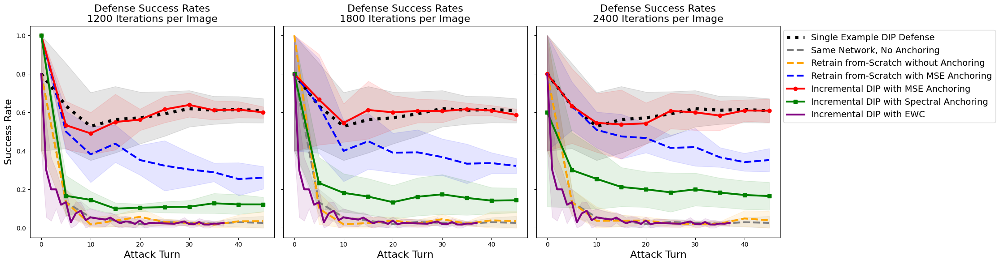

In [32]:
ni_s = [1200, 1800, 2400]
plotting_increment = 5
x_axis = np.arange(0, 50, plotting_increment)

fig, axs = plt.subplots(1, 3, figsize=(22, 6), sharey=True)

for i, ni in enumerate(ni_s):
    ax = axs[i]
    single_example_vanilla_mean, single_example_vanilla_std = inc_concurrent_defense_rates["vanilla"]
    single_example_vanilla_mean, single_example_vanilla_std = single_example_vanilla_mean[::plotting_increment], single_example_vanilla_std[::plotting_increment]
    ax.plot(
        x_axis,
        single_example_vanilla_mean,
        label="Single Example DIP Defense",
        linestyle=":",
        linewidth=5,
        color="black"
    )
    ax.fill_between(
        x_axis,
        np.clip(single_example_vanilla_mean - single_example_vanilla_std, 0, 1),
        np.clip(single_example_vanilla_mean + single_example_vanilla_std, 0, 1),
        alpha=0.1,
        color="black",
    )
    
    # Vanilla incremental:
    vanilla_mean, vanilla_std = incremental_success_rates.get("vanilla", ([],[]))
    vanilla_mean, vanilla_std = vanilla_mean[::plotting_increment], vanilla_std[::plotting_increment]
    ax.plot(
        x_axis,
        vanilla_mean,
        label="Same Network, No Anchoring",
        linestyle="--",
        linewidth=3,
        color="gray"
    )
    ax.fill_between(
        x_axis,
        np.clip(vanilla_mean - vanilla_std, 0, 1),
        np.clip(vanilla_mean + vanilla_std, 0, 1),
        alpha=0.1,
        color="gray",
    )
    
    # Retrain independent:
    retrain_mean, retrain_std = retraining_success_rates.get(f"individual_ni{ni}", ([],[]))
    retrain_mean, retrain_std = retrain_mean[::plotting_increment], retrain_std[::plotting_increment]
    ax.plot(
        x_axis,
        retrain_mean,
        label="Retrain from-Scratch without Anchoring",
        linestyle="--",
        linewidth=3,
        color="orange"
    )
    ax.fill_between(
        x_axis,
        np.clip(retrain_mean - retrain_std, 0, 1),
        np.clip(retrain_mean + retrain_std, 0, 1),
        alpha=0.1,
        color="orange",
    )
    
    # Retrain with mse anchoring:
    retrain_mse_mean, retrain_mse_std = retraining_success_rates.get(f"use_anchor_ni{ni}", ([],[]))
    retrain_mse_mean, retrain_mse_std = retrain_mse_mean[::plotting_increment], retrain_mse_std[::plotting_increment]
    ax.plot(
        x_axis,
        retrain_mse_mean,
        label="Retrain from-Scratch with MSE Anchoring",
        linestyle="--",
        linewidth=3,
        color="blue"
    )
    ax.fill_between(
        x_axis,
        np.clip(retrain_mse_mean - retrain_mse_std, 0, 1),
        np.clip(retrain_mse_mean + retrain_mse_std, 0, 1),
        alpha=0.1,
        color="blue",
    )
    
    # Incremental with mse anchoring (aw=0.5):
    dir_name = f"mse_anchor_aw0.5_ni{ni}"
    inc_mse_mean, inc_mse_std = incremental_success_rates.get(dir_name, ([],[]))
    inc_mse_mean, inc_mse_std = inc_mse_mean[::plotting_increment], inc_mse_std[::plotting_increment]
    if dir_name in incremental_success_rates:
        ax.plot(
            x_axis,
            inc_mse_mean,
            label="Incremental DIP with MSE Anchoring",
            linestyle="-",
            linewidth=3,
            color="red",
            marker='o'
        )
        ax.fill_between(
            x_axis,
            np.clip(inc_mse_mean - inc_mse_std, 0, 1),
            np.clip(inc_mse_mean + inc_mse_std, 0, 1),
            alpha=0.1,
            color="red",
        )
    # Incremental with spectral anchoring (aw=0.5, ma=5):
    dir_name = f"spectral_anchor_ma5_aw0.0005_ni{ni}"
    inc_spec_mean, inc_spec_std = incremental_success_rates.get(dir_name, ([],[]))
    inc_spec_mean, inc_spec_std = inc_spec_mean[::plotting_increment], inc_spec_std[::plotting_increment]
    if dir_name in incremental_success_rates:
        ax.plot(
            x_axis,
            inc_spec_mean,
            label="Incremental DIP with Spectral Anchoring",
            linestyle="-",
            linewidth=3,
            color="green",
            marker='s'
        )
        ax.fill_between(
            x_axis,
            np.clip(inc_spec_mean - inc_spec_std, 0, 1),
            np.clip(inc_spec_mean + inc_spec_std, 0, 1),
            alpha=0.1,
            color="green",
        )
    # EWC-based incremental defense
    dir_name = "ewc"
    ewc_mean, ewc_std = incremental_success_rates.get(dir_name, ([],[]))
    if dir_name in incremental_success_rates:
        ax.plot(
            ewc_mean,
            label="Incremental DIP with EWC",
            linestyle="-",
            linewidth=3,
            color="purple",
        )
        ax.fill_between(
            np.arange(len(ewc_mean)),
            np.clip(ewc_mean - ewc_std, 0, 1),
            np.clip(ewc_mean + ewc_std, 0, 1),
            alpha=0.1,
            color="purple",
        )
    
    ax.set_title(f"Defense Success Rates\n{ni} Iterations per Image", fontsize=16)
    ax.set_xlabel("Attack Turn", fontsize=16)

axs[0].set_ylabel("Success Rate", fontsize=16)
axs[-1].legend(loc='upper right', bbox_to_anchor=(1.9, 1), fontsize=14)
plt.tight_layout()

In [29]:
inc_concurrent_defense_rates["vanilla"]

(array([0.8       , 0.7       , 0.6       , 0.6       , 0.6       ,
        0.63333333, 0.62857143, 0.6       , 0.53333333, 0.52      ,
        0.52727273, 0.51666667, 0.53846154, 0.54285714, 0.56      ,
        0.5625    , 0.56470588, 0.56666667, 0.56842105, 0.58      ,
        0.57142857, 0.57272727, 0.56521739, 0.575     , 0.584     ,
        0.59230769, 0.6       , 0.60714286, 0.6137931 , 0.61333333,
        0.61935484, 0.60625   , 0.60606061, 0.6       , 0.60571429,
        0.61111111, 0.61621622, 0.61052632, 0.61025641, 0.61      ,
        0.61463415, 0.60952381, 0.60930233, 0.60909091, 0.61333333,
        0.60869565, 0.60851064, 0.60416667, 0.60816327, 0.616     ]),
 array([0.4       , 0.4       , 0.24944383, 0.2       , 0.21908902,
        0.22110832, 0.17142857, 0.16583124, 0.14740555, 0.17204651,
        0.17627927, 0.16996732, 0.16135521, 0.16659863, 0.16653328,
        0.17230061, 0.13719887, 0.14656562, 0.14278589, 0.143527  ,
        0.13468701, 0.13360853, 0.14288415, 0.

In [ ]:
log_sources = f"/home/bransthr/projects/aip-florian7/bransthr/DIPDefend/script_logpoint"
defense_type = "incremental"
defense_method = "spectral_anchor_ma5_aw0.0005_ni2400"

log_dir = f"{log_sources}/{defense_type}/{defense_method}"

examplar_mse_logs = process_log(log_dir)

In [ ]:
target_log = examplar_mse_logs


img_idxs_targeted = [
    0, 2, 4, 9, 19, 29, 39, 45, 47, 49
]

def plot_defense_progression(target_log, img_idxs_targeted, defense_turns_targeted):
    num_imgs_targeted = len(img_idxs_targeted)
    fig, axs = plt.subplots(
        (len(defense_turns_targeted) + 2),
        num_imgs_targeted,
        figsize=(num_imgs_targeted * 6, (len(defense_turns_targeted) + 2) * 6)
    )
    label_fontsize = num_imgs_targeted * 3.5

    for row_idx in range(len(defense_turns_targeted) + 2):
        for col_idx in range(num_imgs_targeted):
            ax = axs[row_idx, col_idx]
            
            img_idx = img_idxs_targeted[col_idx]
            
            if row_idx == 0:
                img = target_log['log_stats']['original']['imgs'][img_idx]
                ax.imshow(
                    np.clip(img, 0, 1)
                )
            elif row_idx == 1:
                img = target_log['log_stats']['attacked']['imgs'][img_idx]
                ax.imshow(
                    np.clip(img, 0, 1)
                )
                identified_class = np.argmax(target_log['log_stats']['attacked']['logits'][img_idx])
                ax.set_title(f"Attacked Class:\n{class_id_to_name(identified_class)} ({identified_class})", fontsize=label_fontsize * 0.8)
            else:
                defense_turn = defense_turns_targeted[row_idx - 2]
                if img_idx <= defense_turn:
                    img = target_log['log_stats']['ses_defense']['imgs'][img_idx][defense_turn - img_idx]
                    if img.ndim == 4:
                        img = img.detach()[0].numpy().transpose(1, 2, 0)
                    ax.imshow(
                        np.clip(img, 0, 1)
                    )
                    identified_class = np.argmax(target_log['log_stats']['ses_defense']['logits'][img_idx][defense_turn - img_idx])
                    ax.set_title(f"Defended Class:\n{class_id_to_name(identified_class)} ({identified_class})", fontsize=label_fontsize * 0.8)

                    
            ax.set_xticks([])
            ax.set_yticks([])
            for spine in ax.spines.values():
                spine.set_visible(False)

    axs[0, 0].set_ylabel("Original", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
    axs[1, 0].set_ylabel("Attacked", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
    for i in range(len(defense_turns_targeted)):
        axs[i + 2, 0].set_ylabel(f"Defended\n Attack Turn {defense_turns_targeted[i] + 1}", fontsize=label_fontsize, rotation=0, labelpad=label_fontsize * 4)
    for i in range(len(img_idxs_targeted)):
        current_class = np.argmax(target_log['log_stats']['original']['logits'][i])
        axs[0, i].set_title(f"Img {img_idxs_targeted[i]}\nOriginal Class:\n{class_id_to_name(current_class)} ({current_class})", fontsize=label_fontsize * 0.9)

    plt.tight_layout()
    plt.show()

In [ ]:
compute_attack_success_rate(examplar_mse_logs)

np.float64(0.9)

NameError: name 'class_id_to_name' is not defined

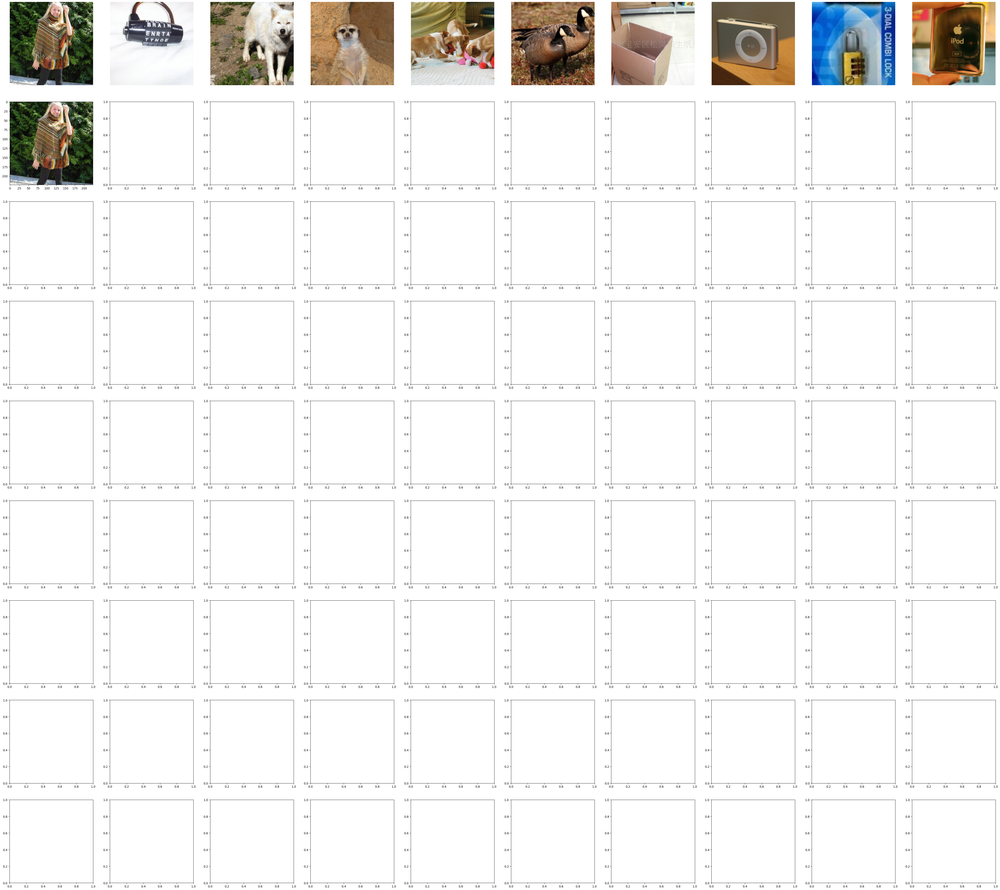

In [ ]:
target_log = examplar_mse_logs


defense_turns = [
    0, 2, 4, 19, 35, 45, 49
]
img_idxs_targeted = [
    0, 2, 4, 9, 19, 24, 29, 35, 43, 49
]


plot_defense_progression(target_log, img_idxs_targeted, defense_turns)

In [ ]:
# Record the PSNR and MSE of each image with respect to its original defense version
psnr_records = {}
mse_records = {}
target_log = examplar_mse_logs

for attack_turn_idx in range(target_log['num_attacks_recorded']):
    for defense_idx in range(attack_turn_idx + 1):
        original_img = target_log['log_stats']['attacked']['imgs'][defense_idx]
        defended_img = target_log['log_stats']['ses_defense']['imgs'][defense_idx][attack_turn_idx - defense_idx]
        if defended_img.ndim == 4: 
            defended_img = defended_img.detach().numpy()[0].transpose(1, 2, 0)
        
        mse = np.mean((original_img - defended_img) ** 2)
        psnr = 10 * np.log10(1.0 / mse)
        psnr_records[(attack_turn_idx, defense_idx)] = psnr
        mse_records[(attack_turn_idx, defense_idx)] = mse

In [ ]:
# Record the PSNR and MSE of each image with respect to its original defense version
psnr_records_for_defs = {}
mse_records_for_defs = {}
target_log = examplar_mse_logs

for attack_turn_idx in range(target_log['num_attacks_recorded']):
    for defense_idx in range(0, attack_turn_idx + 1):
        benchmark_img = target_log['log_stats']['ses_defense']['imgs'][defense_idx][0]
        defended_img = target_log['log_stats']['ses_defense']['imgs'][defense_idx][attack_turn_idx - defense_idx]
        if defended_img.ndim == 4: 
            defended_img = defended_img.detach().numpy()[0].transpose(1, 2, 0)
        
        mse = np.mean((benchmark_img - defended_img) ** 2)
        if mse == 0:
            continue
        psnr = 10 * np.log10(1.0 / (mse + 1e-5))
        psnr_records_for_defs[(attack_turn_idx, defense_idx)] = psnr
        mse_records_for_defs[(attack_turn_idx, defense_idx)] = mse

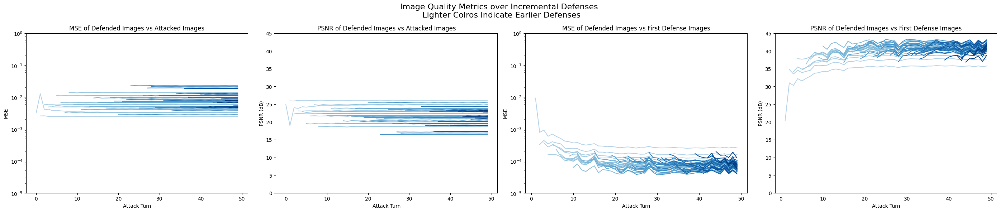

In [ ]:
blues = plt.get_cmap('Blues')
colors = blues(np.linspace(0.3, 1.0, target_log['num_attacks_recorded']))

fig, ax = plt.subplots(1, 4, figsize=(28, 6))
for defense_idx in range(target_log['num_attacks_recorded']):
    mse_records_of_this_attack = [
        mse_records[(j, defense_idx)] for j in range(defense_idx, target_log['num_attacks_recorded'])
    ]
    psnr_records_of_this_attack = [
        psnr_records[(j, defense_idx)] for j in range(defense_idx, target_log['num_attacks_recorded'])
    ]
    ax[0].plot(
        range(defense_idx, target_log['num_attacks_recorded']),
        mse_records_of_this_attack,
        label=f"Defense on Attack Turn {defense_idx + 1}",
        color=colors[defense_idx]
    )
    ax[1].plot(
        range(defense_idx, target_log['num_attacks_recorded']),
        psnr_records_of_this_attack,
        label=f"Defense on Attack Turn {defense_idx + 1}",
        color=colors[defense_idx]
    )
    mse_records_of_this_attack_for_defs = [
        mse_records_for_defs[(j, defense_idx)] for j in range(defense_idx + 1, target_log['num_attacks_recorded'])
    ]
    psnr_records_of_this_attack_for_defs = [
        psnr_records_for_defs[(j, defense_idx)] for j in range(defense_idx + 1, target_log['num_attacks_recorded'])
    ]
    ax[2].plot(
        range(defense_idx + 1, target_log['num_attacks_recorded']),
        mse_records_of_this_attack_for_defs,
        label=f"Defense on Attack Turn {defense_idx + 1}",
        color=colors[defense_idx]
    )
    ax[3].plot(
        range(defense_idx + 1, target_log['num_attacks_recorded']),
        psnr_records_of_this_attack_for_defs,
        label=f"Defense on Attack Turn {defense_idx + 1}",
        color=colors[defense_idx]
    )
ax[0].set_title("MSE of Defended Images vs Attacked Images")
ax[0].set_xlabel("Attack Turn", fontsize=16)
ax[0].set_ylabel("MSE", fontsize=16)
ax[0].set_yscale("log")
ax[0].set_ylim(1e-5, 1)
# ax[0].legend()
ax[1].set_title("PSNR of Defended Images vs Attacked Images")
ax[1].set_xlabel("Attack Turn", fontsize=16)
ax[1].set_ylabel("PSNR (dB)", fontsize=16)
ax[1].set_ylim(0, 45)
# ax[1].legend()
ax[2].set_title("MSE of Defended Images vs First Defense Images")
ax[2].set_xlabel("Attack Turn", fontsize=16)
ax[2].set_ylabel("MSE", fontsize=16)
ax[2].set_yscale("log")
ax[2].set_ylim(1e-5, 1)
# ax[2].legend()
ax[3].set_title("PSNR of Defended Images vs First Defense Images")
ax[3].set_xlabel("Attack Turn", fontsize=16)
ax[3].set_ylabel("PSNR (dB)", fontsize=16)
ax[3].set_ylim(0, 45)
# ax[3].legend()

fig.suptitle("Image Quality Metrics over Incremental Defenses \n Lighter Colros Indicate Earlier Defenses", fontsize=20)
plt.tight_layout()